#DATA MINING PROJECT 

## Subject : Problem

### Jake McCoy & Théo Lavandier, Group 135

  
  *This is the notebook for the Data Mining 2022/2023 project.  
  It contains all the code we used to work on our problem, as  
  well as the different graphs we talk about in our report.*  

  *In this notebook we study data on houses in California.    
  We study each aspect of our data trying to understand the   
  relationships between each attribute and the interpretation  
  we can give. We also create statistical prediction models  
  based on the data we have in our possession, in order to  
  have simple and powerful prediction models.*     

  *To have explanations on the notebook, we invite you to   
  consult our project report. You will find all the explanations   
  on the analysis of these data.*  

In [ ]:
#--- Cell 1 ---#
from sklearn.datasets import fetch_california_housing
import numpy as np
import pandas as pd
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.utils import random
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

In [ ]:
#--- Cell 2 ---#

## Data Collection
#Data as a numpy array
X, y = fetch_california_housing(return_X_y=True, as_frame=False)

#Data as a panda dataframe
df = fetch_california_housing(as_frame=True)

In [ ]:
#--- Cell 3 ---#
## Pre-processing


# Removing all values above 5.000001 pricings
df['data']   = df['data'][df['target'] < 5]
df['target'] = df['target'][df['target'] < 5]
full_df = df['data']
full_df['MedPrice'] = df['target']
indexes = [] # indexes of the corrupted values
for i in range(len(y)):
  if y[i] > 5:
    indexes.append(i)

# Remove all values with the indexes identified above
X=np.delete(X, indexes, axis=0)
y=np.delete(y, indexes, axis=0)

X_with_Y = np.insert(X,8,y,axis=1)

print("Maximum Housing Value = " + str(max(y)))

## All the data with a price above 5 is deleted

#------------------------------------------------------------------------------------------------------

# Standardisation
#Scaler used to standardize our data 
scaler = StandardScaler()

#Stardardize the data using the scaler (Data is variable X)
standardized_data = scaler.fit_transform(X)

#Prints out all of our currect data after standardization
print("All of the data after standardization:")
print(standardized_data)

#-------------------------------------------------------------------------------------------------------

#Sampling
#Here we get a list of random indexes based on the attributes of our data (Here it is X)
sampled_data = random.sample_without_replacement(n_population=len(standardized_data), n_samples=8000, random_state=2)

#Save all the data from the random index list and remove all other data points
data_preprocessed = standardized_data[sampled_data]
X_sampled = data_preprocessed
y_sampled = y[sampled_data]
#Prints all our data out
print("All of our data after all preprocessing has been done:")
print(X_sampled)

X_with_Y_post = np.insert(X_sampled,8,y_sampled,axis=1)

Maximum Housing Value = 5.0
All of the data after standardization:
[[ 2.96038034  1.00838834  0.70806549 ... -0.050757    1.03650334
  -1.32937755]
 [ 2.94522334 -0.5904867   0.3826581  ... -0.09268007  1.02719992
  -1.32439265]
 [ 2.28035331  1.88776961  1.27688557 ... -0.02755242  1.02254821
  -1.33436245]
 ...
 [-1.25886958 -0.9102617  -0.06776868 ... -0.07238292  1.75751838
  -0.82590242]
 [-1.15238848 -0.83031795 -0.0136918  ... -0.09142276  1.75751838
  -0.87575144]
 [-0.82033558 -0.99020545 -0.04631844 ... -0.04497942  1.72960812
  -0.83587222]]
All of our data after all preprocessing has been done:
[[-0.8151771   1.16827584 -0.18706451 ... -0.06267238  0.52016354
  -0.11306139]
 [ 2.00141359 -0.99020545  1.04680642 ...  0.02762489  0.74809733
  -1.13995126]
 [-1.38082611 -0.9102617  -0.57112808 ... -0.02217504  1.61796708
  -0.9953891 ]
 ...
 [ 0.05443978 -0.99020545 -0.212043   ... -0.04550605  0.81322127
  -1.16487578]
 [ 0.717654   -0.67043045  0.00396903 ... -0.08749198  0.

Explained Variance of the PC's: 0.6469342303917189



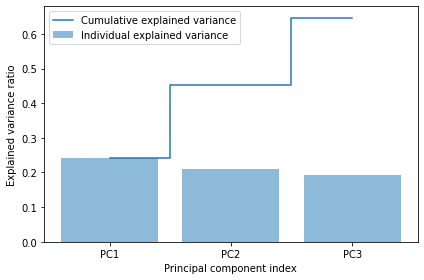

Figure 1: The principle components plotted against their explained variance with their cumulative variance


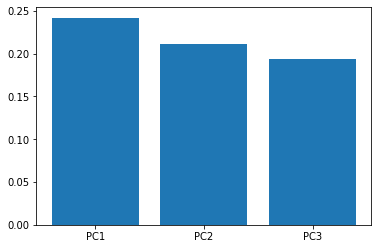

Figure 2: The principle components plotted against their explained variance


In [ ]:
#--- Cell 4 ---#

#Instantiate PCA
pca = PCA(n_components=3)

# Determine transformed features
X_pca = pca.fit_transform(X_sampled)

# Determine explained variance using explained_variance_ration_ attribute
exp_var_pca = pca.explained_variance_ratio_
print("Explained Variance of the PC's: " + str(exp_var_pca.sum()) + "\n")

cum_sum_eigenvalues = np.cumsum(exp_var_pca)

# Plot pca variance
plt.bar(["PC1","PC2","PC3"]
        ,exp_var_pca, alpha=0.5
        ,align='center'
        ,label='Individual explained variance')

plt.step(["PC1","PC2","PC3"]
         ,cum_sum_eigenvalues
         ,where='mid'
         ,label='Cumulative explained variance')

plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()
print("Figure 1: The principle components plotted against their explained variance with their cumulative variance")

variance_bar_plot = plt.figure()
plt.bar(["PC1","PC2","PC3"],exp_var_pca)
plt.show()
print("Figure 2: The principle components plotted against their explained variance")

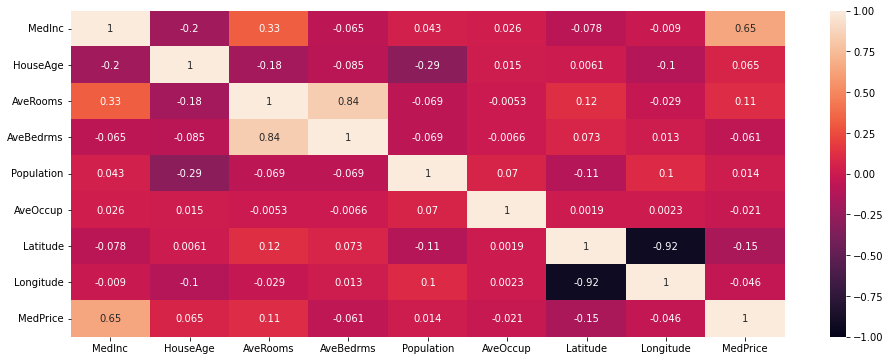

Figure 3: Correlation matrix of our data set after removal of inaccurate data points


In [ ]:
#--- Cell 5 ---#
# Correlation Matrix of our dataset

plt.figure(figsize=(16, 6))

sns.heatmap(full_df.corr(), vmin=-1, vmax=1, annot=True)
plt.show()
print("Figure 3: Correlation matrix of our data set after removal of inaccurate data points")

In [ ]:
#--- Cell 6 ---#

attributesX = ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude', 'MedPrice']

fig, axs = plt.subplots(9,9,figsize=(150,150))

for ind in range(len(attributesX)):
    for ind2 in range(len(attributesX)):
        axs[ind, ind2].scatter(X_with_Y_post[:,ind], X_with_Y_post[:,ind2], c = y_sampled)
        axs[ind, ind2].set_xlabel(attributesX[ind], fontsize=60)
        axs[ind, ind2].set_ylabel(attributesX[ind2], fontsize=60)

plt.show()
print("Figure 4: Scatter matrix of our dataset")

Figure 4: Scatter matrix of our dataset


In [ ]:
#--- Cell 7 ---#

px.set_mapbox_access_token("pk.eyJ1IjoidGVzdHRlc3Rlc3Rlc3RlcyIsImEiOiJjbDNibjExbGYwM2JxM3BsbGQwNW1iY2ZnIn0.DL5BPUZbJCLewyztQvzrFQ")

fig = px.scatter_mapbox(full_df, 
                        lat='Latitude', 
                        lon='Longitude', 
                        size='Population', 
                        color='MedPrice',
                        color_continuous_scale=px.colors.cyclical.IceFire, 
                        size_max=20, 
                        zoom=10)

fig.show()
print("Figure 5: All our data plotted on the map of California")

Figure 5: All our data plotted on the map of California


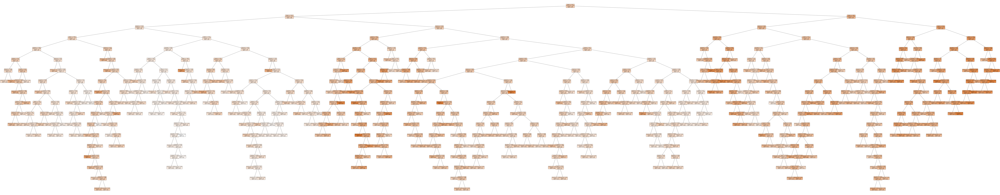

Figure 6: Visual Representation of a Regression Decision Tree with random parameters

Mean absolute error:	0.42	(2 significant figures)
Mean absolute error:	0.4182399774268526
R2 Score:		60.0%	(2 significant figures)
R2 Score:		0.5976326614185897



In [ ]:
#--- Cell 8 ---#

## Defning a Decision Tree
#Packages we will use
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score

#Training the Decision Tree
X_train, X_test, y_train, y_test = train_test_split(X_sampled, y[sampled_data], test_size=0.33, random_state=42)
#DT = DecisionTreeRegressor(min_samples_split=44, max_depth=17)
DT = DecisionTreeRegressor(min_samples_split=35, max_depth=17)
DT.fit(X_train, y_train)

#Plotting the Tree visually
plt.figure(figsize =(250,50))
plot_tree(DT, feature_names = attributesX, fontsize=10, filled=True, rounded=True)
plt.show()
print("Figure 6: Visual Representation of a Regression Decision Tree with random parameters\n")

#Analysis of the performances of this decision tree with random parameters
prediction = DT.predict(X_test)

# compute the mean absolute error
DT_mae = mean_absolute_error(y_test, prediction)
print("Mean absolute error:\t{}\t(2 significant figures)".format(round(DT_mae, 2)))
print("Mean absolute error:\t{}".format(DT_mae))

#-- R2 Score --#
DT_score = r2_score(y_test, prediction)
print("R2 Score:\t\t{}%\t(2 significant figures)".format(round(DT_score, 2) *100))
print("R2 Score:\t\t{}\n".format(DT_score))



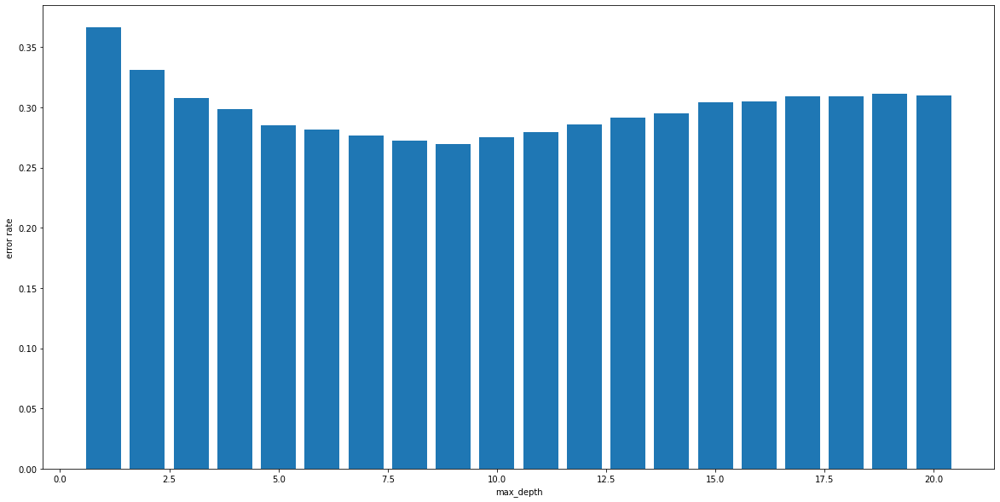

Figure 7: Bar plot of Mean Absolute Error against Maximum Depth values

By looking at this graph we can see that the best value of max_depth for our DT model should be 9.


In [ ]:
#--- Cell 9 ---#

# KFold to find the best tree depth
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import KFold

error_rate_list = []

for k in range(1,21):
  kf = KFold(n_splits=10)
  k_error_rate = []
  for train, test in kf.split(X):
    X_train, X_test, y_train, y_test = X[train], X[test], y[train], y[test]
    DT = DecisionTreeRegressor(min_samples_split=2, max_depth=k, random_state=1)
    DT.fit(X_train, y_train)
    prediction = DT.predict(X_test)
    mae = mean_absolute_error(y_test, prediction)
    mse = mean_squared_error(y_test, prediction)
    accuracy = 1 - mae / y_test.mean()
    error_rate = 1 - accuracy
    k_error_rate.append(error_rate)
  error_rate_list.append(np.mean(k_error_rate))

plt.figure(figsize=(20,10))
plt.bar(range(1,21),error_rate_list)
plt.xlabel("max_depth")
plt.ylabel("Error rate")
plt.show()
print("Figure 7: Bar plot of Mean Absolute Error against Maximum Depth values\n")

print('By looking at this graph we can see that the best value of max_depth for our DT model should be 9.')

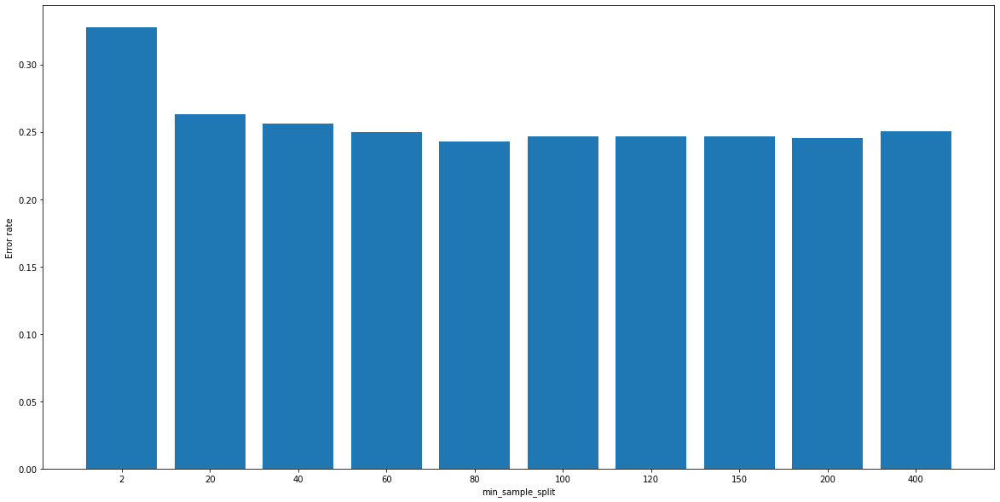

Figure 8: Bar plot of Mean Absolute Error against Minimum Split Value's

By looking at this graph we can see that the best value of min_sample_split for our DT model should be 80


In [ ]:
#--- Cell 10 ---#

# KFold to find the best minimum number of splits
error_rate_list = []
splits = [2,20,40,60,80,100,120,150,200,400]
for k in range(0,len(splits)):
  kf = KFold(n_splits=splits[k])
  k_error_rate = []
  for train, test in kf.split(X):
    X_train, X_test, y_train, y_test = X[train], X[test], y[train], y[test]
    DT = DecisionTreeRegressor(min_samples_split=splits[k], max_depth=9, random_state=1)
    DT.fit(X_train, y_train)
    prediction = DT.predict(X_test)
    mae = mean_absolute_error(y_test, prediction)
    mse = mean_squared_error(y_test, prediction)
    accuracy = 1 - mae / y_test.mean()
    error_rate = 1 - accuracy
    k_error_rate.append(error_rate)
  error_rate_list.append(np.mean(k_error_rate))

plt.figure(figsize=(20,10))
plt.bar([str(x) for x in splits],error_rate_list)
plt.xlabel('min_sample_split')
plt.ylabel("Error rate")
plt.show()
print("Figure 8: Bar plot of Mean Absolute Error against Minimum Split Value's\n")

print('By looking at this graph we can see that the best value of min_sample_split for our DT model should be 80')

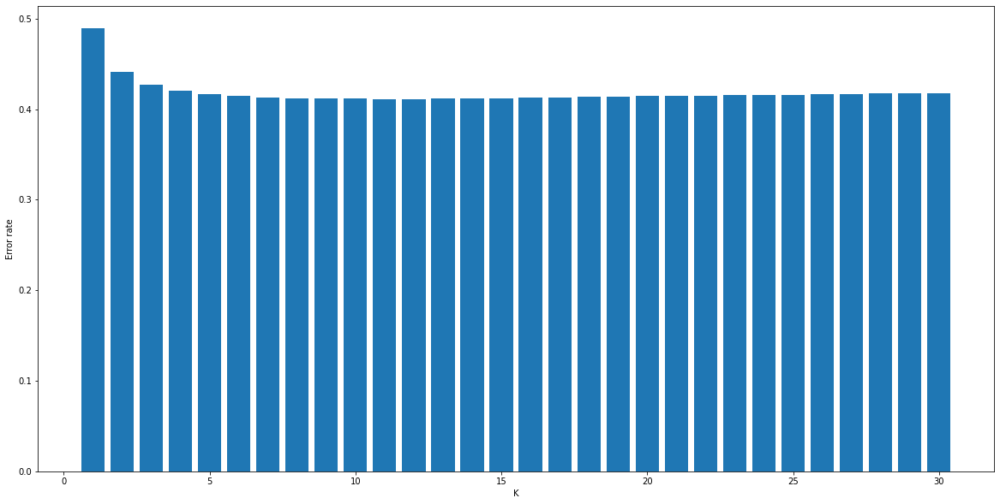

Figure 9: Value of K against Error rate

By looking at this graph we can see that the best value of K for our KNN model should be 12


In [ ]:
#--- Cell 11 ---#

## Find the best k value for KNN
from sklearn.neighbors import KNeighborsRegressor

error_rate_list = []

for k in range(1,31):
  kf = KFold(n_splits=10)
  k_error_rate = []
  for train, test in kf.split(X):
    X_train, X_test, y_train, y_test = X[train], X[test], y[train], y[test]
    knn = KNeighborsRegressor(k, weights="distance")
    knn.fit(X_train, y_train)
    prediction = knn.predict(X_test)
    mae = mean_absolute_error(y_test, prediction)
    mse = mean_squared_error(y_test, prediction)
    accuracy = 1 - mae / y_test.mean()
    error_rate = 1 - accuracy
    k_error_rate.append(error_rate)
  error_rate_list.append(np.mean(k_error_rate))

plt.figure(figsize=(20,10))
plt.bar(range(1,31),error_rate_list)
plt.xlabel('K')
plt.ylabel('Error rate')
plt.show()

print(f'Figure 9: Value of K against Error rate\n')

print('By looking at this graph we can see that the best value of K for our KNN model should be 12')

In [ ]:
#--- Cell 12 ---#
# Optimized Models

X_train, X_test, y_train, y_test = train_test_split(X_sampled, y_sampled, test_size=0.33, random_state=42)

# Optimized KNN regressor
KKN_model = KNeighborsRegressor(n_neighbors=12)
KKN_model.fit(X_train, y_train)

# Optimized Decision Tree Regressor
DT = DecisionTreeRegressor(min_samples_split=80, max_depth=9, random_state=1)
DT.fit(X_train, y_train)



DecisionTreeRegressor(max_depth=9, min_samples_split=80, random_state=1)

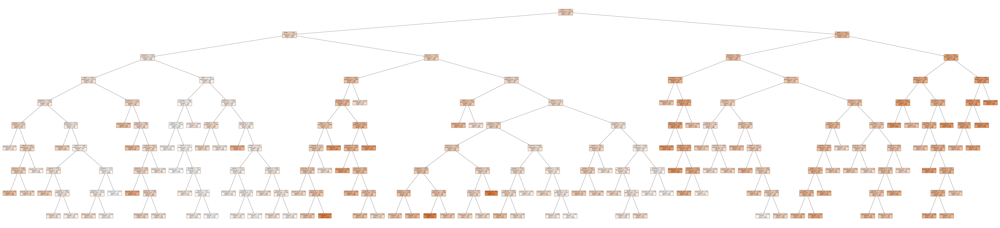

Figure 10: Visual Representation of a Regression Decision Tree with optimized parameters


In [ ]:
#--- Cell 13 ---#
# Plot of the optimized Decision tree

#Plotting the Tree visually
plt.figure(figsize =(150,35))
plot_tree(DT, feature_names = attributesX, fontsize=10, filled=True, rounded=True)
plt.show()
print("Figure 10: Visual Representation of a Regression Decision Tree with optimized parameters")




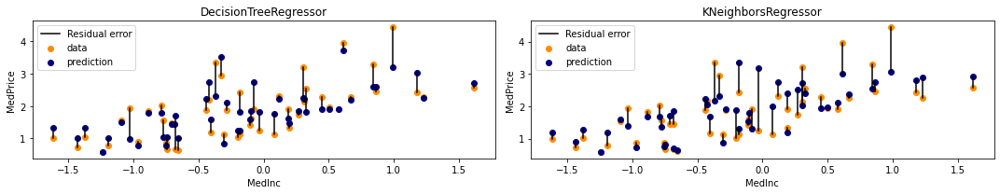

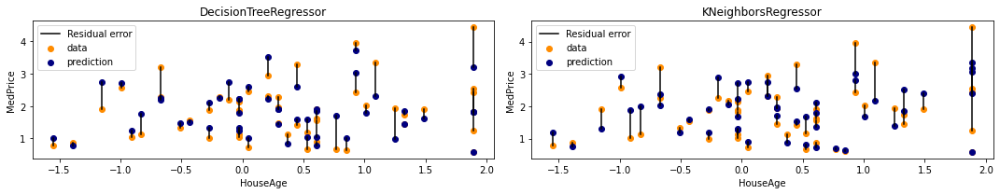

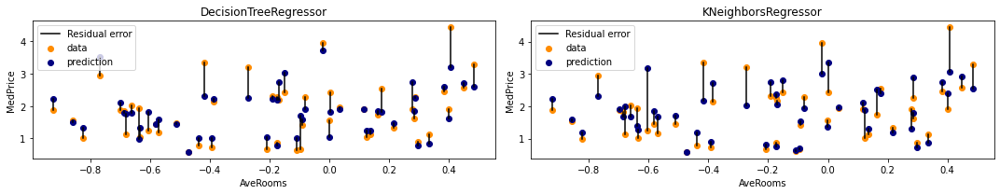

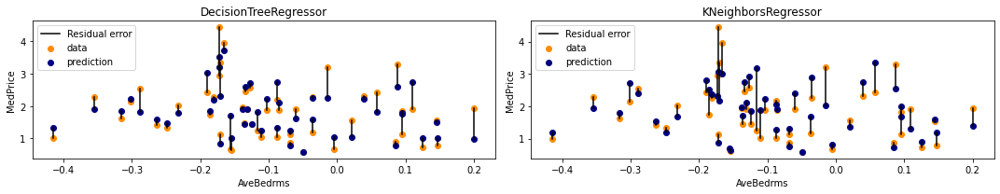

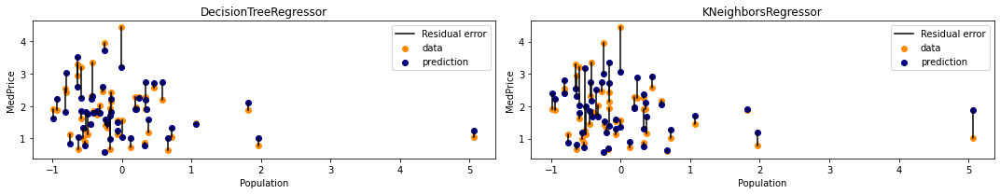

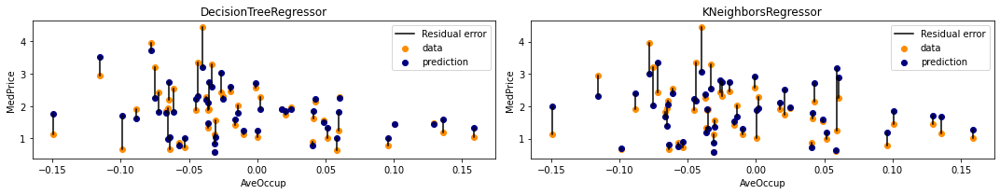

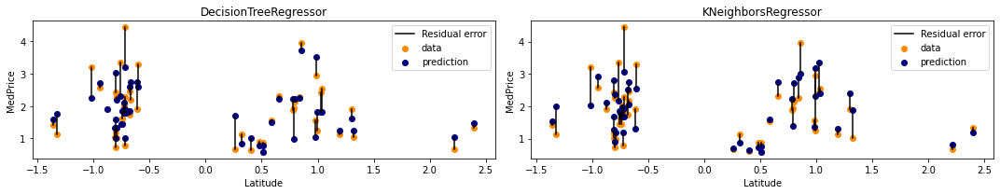

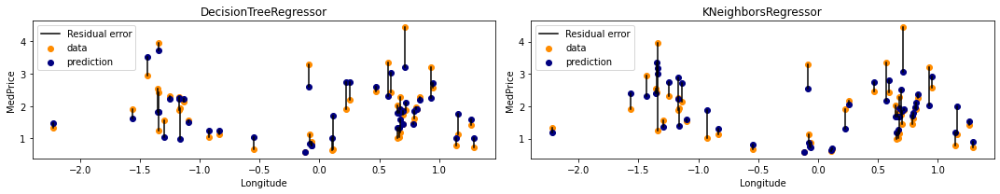

Figure 11: Predictions comparision between DecisionTreeRegressor and KNeighborsRegressor on 30 random data points


In [ ]:
 #--- Cell 14 ---#
 # Visualization of the predictions comparision between the two models
import random

attributes = ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']

# Compute predictions for both regressors
predDT = DT.predict(X_test)
predKNN = KKN_model.predict(X_test)

# Create a random sample of 30 datapoints to visualize them
sample_size = 50
smpl = random.sample(range(2639), sample_size)

# Create the plot
for x, attribute in enumerate(attributes):
  figure, axs = plt.subplots(1,2,figsize=(15,3))
  axs[0].scatter(X_test[:,x][smpl], y_test[smpl], color="darkorange", label="data")
  axs[0].scatter(X_test[:,x][smpl], predDT[smpl], color="navy", label="prediction")
  axs[1].scatter(X_test[:,x][smpl], y_test[smpl], color="darkorange", label="data")
  axs[1].scatter(X_test[:,x][smpl], predKNN[smpl], color="navy", label="prediction")
  for ind, i in enumerate(smpl):
      if ind==0:
        axs[0].plot([X_test[:,x][i],X_test[:,x][i]], [y_test[i], predDT[i]], color="black", label="Residual error")
        axs[1].plot([X_test[:,x][i],X_test[:,x][i]], [y_test[i], predKNN[i]], color="black", label="Residual error")
      else:
        axs[0].plot([X_test[:,x][i],X_test[:,x][i]], [y_test[i], predDT[i]], color="black")
        axs[1].plot([X_test[:,x][i],X_test[:,x][i]], [y_test[i], predKNN[i]], color="black")
  axs[0].axis("tight")
  axs[1].axis("tight")
  axs[0].set_xlabel(attribute)
  axs[1].set_xlabel(attribute)
  axs[0].set_ylabel("MedPrice")
  axs[1].set_ylabel("MedPrice")
  axs[0].legend(loc='best')
  axs[1].legend(loc='best')
  axs[0].set_title("DecisionTreeRegressor")
  axs[1].set_title("KNeighborsRegressor")
  plt.tight_layout()
  plt.show()

print("Figure 11: Predictions comparision between DecisionTreeRegressor and KNeighborsRegressor on 30 random data points")

In [ ]:
 #--- Cell 15 ---#
 # Comparision of our models performances
X_train, X_test, y_train, y_test = train_test_split(X_sampled, y_sampled, test_size=0.33, random_state=42)

## Test of the decision tree (MAE and R2 Score)
print("Regression Tree Model:")
#-- MAE --#
# predict the target values for the test data
prediction = DT.predict(X_test)

# compute the mean absolute error
DT_mae = mean_absolute_error(y_test, prediction)
print("Mean absolute error:\t{}\t(2 significant figures)".format(round(DT_mae, 2)))
print("Mean absolute error:\t{}".format(DT_mae))

#-- R2 Score --#
from sklearn.metrics import r2_score
DT_score = r2_score(y_test, prediction)
print("R2 Score:\t\t{}%\t(2 significant figures)".format(round(DT_score, 2) *100))
print("R2 Score:\t\t{}\n".format(DT_score))



##Test of the KNN Model (MAE and R2 Score)
print("K-Nearest Neighbours Model")
#-- MAE --#
prediction_R2 = KKN_model.predict(X_test)

# compute the mean absolute error
R2_mae = mean_absolute_error(y_test, prediction_R2)
print("Mean absolute error:\t{}\t(2 significant figures)".format(round(R2_mae, 2)))
print("Mean absolute error:\t{}".format(R2_mae))

#-- R2 Score --#
R2_score = r2_score(y_test, prediction_R2)
print("R2 Score:\t\t{}%\t(2 significant figures)".format(round(R2_score, 2) *100))
print("R2 Score:\t\t{}\n".format(R2_score))

Regression Tree Model:
Mean absolute error:	0.43	(2 significant figures)
Mean absolute error:	0.4261080106505443
R2 Score:		61.0%	(2 significant figures)
R2 Score:		0.6097963831819633

K-Nearest Neighbours Model
Mean absolute error:	0.43	(2 significant figures)
Mean absolute error:	0.43137572601010093
R2 Score:		61.0%	(2 significant figures)
R2 Score:		0.6086784284650452

